# 1. Introduction 


In this project for IT1244, we wish to explore the application of **classification** method in **image datasets**. 

Specifically, we will be using the **brain tumor datasets**, where we intend to build a model that is capable of differentiating **benign** and **malignant** tumors.

A general flow of the working process is as follows: **(as outlined in the table of contents)**

1. Data Preprocessing
2. Various Models for Classification
3. Model Evaluation Metrics

# 2. Data Preprocessing

## 2.1 Importing Libraries and Dataset

First, we will import the necessary libraries, and import the dataset into the current runtime.

In [ ]:
#importing libraries
import numpy as np
import pandas as pd 
import cv2
import os
import imutils
import matplotlib.pyplot as plt

from google.colab import files
from os import listdir
from prettytable import PrettyTable

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D,Input,BatchNormalization,Flatten,Activation,Dense,MaxPooling2D
from tensorflow.keras.metrics import Recall
from tensorflow.keras.callbacks import ModelCheckpoint
from keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.utils import plot_model
from tensorflow.keras.regularizers import l2

from sklearn.tree import DecisionTreeClassifier,export_graphviz
from sklearn.svm import SVC, LinearSVC
from sklearn.model_selection import train_test_split,cross_val_score,GridSearchCV
from sklearn.utils import shuffle #shuffling the data improves the model
from sklearn.metrics import confusion_matrix,accuracy_score,classification_report,make_scorer

In [ ]:
# set working directory 
root_dir = "/content/"

def setwd(project_folder):
  if os.path.isdir(root_dir + project_folder) == False:
    os.makedirs(root_dir + project_folder)
    print(root_dir + project_folder + ' succesfully created.')

  os.chdir(root_dir + project_folder)

In [ ]:
# create benign folder
setwd("data/benign")
files.upload()

/content/data/benign succesfully created.


Saving 1.jpg to 1.jpg
Saving 2.jpg to 2.jpg
Saving 3.jpg to 3.jpg
Saving 4.jpg to 4.jpg
Saving 5.jpg to 5.jpg
Saving 6.jpg to 6.jpg
Saving 7.jpg to 7.jpg
Saving 8.jpg to 8.jpg
Saving 9.jpg to 9.jpg
Saving 10.jpg to 10.jpg
Saving 11.jpg to 11.jpg
Saving 12.jpg to 12.jpg
Saving 13.jpg to 13.jpg
Saving 14.jpg to 14.jpg
Saving 15.jpg to 15.jpg
Saving 17.jpg to 17.jpg
Saving 18.jpg to 18.jpg
Saving 19.jpg to 19.jpg
Saving 20.jpg to 20.jpg
Saving 21.jpg to 21.jpg
Saving 22.jpg to 22.jpg
Saving 23.jpg to 23.jpg
Saving 24.jpg to 24.jpg
Saving 25.jpg to 25.jpg
Saving 26.jpg to 26.jpg
Saving 27.jpg to 27.jpg
Saving 28.jpg to 28.jpg
Saving 29.jpg to 29.jpg
Saving 30.jpg to 30.jpg
Saving 31.jpg to 31.jpg
Saving 32.jpg to 32.jpg
Saving 33.jpg to 33.jpg
Saving 34.jpg to 34.jpg
Saving 35.jpg to 35.jpg
Saving 36.jpg to 36.jpg
Saving 37.jpg to 37.jpg
Saving 38.jpg to 38.jpg
Saving 39.jpg to 39.jpg
Saving 40.jpg to 40.jpg
Saving 41.jpg to 41.jpg
Saving 42.jpg to 42.jpg
Saving 43.jpg to 43.jpg
Saving 44n

{'1.jpg': b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x02\x00&\x00&\x00\x00\xff\xdb\x00C\x00\x03\x02\x02\x02\x02\x02\x03\x02\x02\x02\x03\x03\x03\x03\x04\x06\x04\x04\x04\x04\x04\x08\x06\x06\x05\x06\t\x08\n\n\t\x08\t\t\n\x0c\x0f\x0c\n\x0b\x0e\x0b\t\t\r\x11\r\x0e\x0f\x10\x10\x11\x10\n\x0c\x12\x13\x12\x10\x13\x0f\x10\x10\x10\xff\xc0\x00\x0b\x08\x02v\x02v\x01\x01\x11\x00\xff\xc4\x00\x1d\x00\x00\x01\x04\x03\x01\x01\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x02\x03\x05\x06\x01\x04\x07\x08\t\xff\xc4\x00@\x10\x00\x02\x01\x03\x03\x02\x05\x03\x02\x05\x03\x03\x03\x02\x07\x01\x01\x02\x03\x00\x04\x11\x05\x12!\x061\x07\x13"AQ\x082a\x14q\x15#B\x81\xa1R\x91\xb1\x16$\xc13Cbr\xd1\x17%S\x92\xe1\xf0\xf1\x82\xff\xda\x00\x08\x01\x01\x00\x00?\x00\xf9UE\x14QE\x14QE\x14QE\x14QE\x14QE\x14QE\x14QE\x14QE\x14QE\x14QE\x14QE\x14QE\x14QE\x14QE\x14QE\x14QE\x14QE\x14QE\x14QE\x14QE\x14QE\x14QE\x14QE\x14QE\x14QE\x14QE\x14QE\x00\x1c\xe2\xb3\xb1\xb3\x8cb\x94bo\xdf\x1d\xe9K\n\xb7\x00\xe4\xfcR\xcd\xb8R\x17\xb9=\xe8X\x13;[9\x

In [ ]:
# create malignant folder
setwd("data/malignant")
files.upload()

/content/data/malignant succesfully created.


Saving 1.jpg to 1.jpg
Saving 2.jpg to 2.jpg
Saving 3.jpg to 3.jpg
Saving 4.jpg to 4.jpg
Saving 6.jpg to 6.jpg
Saving 7.jpg to 7.jpg
Saving 8.jpg to 8.jpg
Saving 9.jpg to 9.jpg
Saving 10.jpg to 10.jpg
Saving 11.jpg to 11.jpg
Saving 12.jpg to 12.jpg
Saving 13.jpg to 13.jpg
Saving 14.jpg to 14.jpg
Saving 15.jpg to 15.jpg
Saving 16.jpg to 16.jpg
Saving 17.jpg to 17.jpg
Saving 18.jpg to 18.jpg
Saving 19.jpg to 19.jpg
Saving 20.jpg to 20.jpg
Saving 21.jpg to 21.jpg
Saving 22.jpg to 22.jpg
Saving 23.jpg to 23.jpg
Saving 24.jpg to 24.jpg
Saving 25.jpg to 25.jpg
Saving 26.jpg to 26.jpg
Saving 27.jpg to 27.jpg
Saving 28.jpg to 28.jpg
Saving 29.jpg to 29.jpg
Saving 30.jpg to 30.jpg
Saving 31.jpg to 31.jpg
Saving 32.jpg to 32.jpg
Saving 33.jpg to 33.jpg
Saving 34.jpg to 34.jpg
Saving 35.jpg to 35.jpg
Saving 36.jpg to 36.jpg
Saving 37.jpg to 37.jpg
Saving 38.jpg to 38.jpg
Saving 39.jpg to 39.jpg
Saving 40.jpg to 40.jpg
Saving 41.jpg to 41.jpg
Saving 42.jpg to 42.jpg
Saving 44.jpg to 44.jpg
Saving 4

{'1.jpg': b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00\x00\x01\x00\x01\x00\x00\xff\xdb\x00\x84\x00\t\x06\x07\x14\x13\x12\x15\x14\x13\x14\x16\x14\x15\x15\x18\x17\x18\x18\x17\x18\x17\x14\x17\x18\x18\x15\x17\x14\x17\x17\x14\x18\x14\x17\x18\x1c( \x18\x1a%\x1c\x14\x14!1!%)+...\x17\x1f383,7(-.+\x01\n\n\n\x05\x05\x05\x0e\x05\x05\x0e+\x19\x13\x19++++++++++++++++++++++++++++++++++++++++++++++++++\xff\xc0\x00\x11\x08\x00\xda\x00\xb4\x03\x01"\x00\x02\x11\x01\x03\x11\x01\xff\xc4\x00\x1c\x00\x00\x01\x05\x01\x01\x01\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x04\x00\x01\x03\x05\x06\x02\x07\x08\xff\xc4\x00?\x10\x00\x01\x03\x02\x04\x04\x04\x03\x05\x05\x07\x05\x01\x00\x00\x00\x01\x00\x02\x11\x03\x04\x12!1A\x05\x06Qa\x13"q\x912\x81\xa1#Bb\xb1\xc1\x143Rr\xf0\x07$\x82\xa2\xb2\xc2\xd1\x15C\x92\xe1\xf1c\xff\xc4\x00\x14\x01\x01\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\xff\xc4\x00\x14\x11\x01\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\xff\xda\x00\x0c\x03\x01\x00\x02\

## 2.2 Data Augmentation

Observing the datasets, we can notice that there are currently 154 instances of "Malignant" pictures and 77 instances of "Benign" pictures.

In an attempt to create more inputs based on the current input, we wish to augment our datas to add more samples and balance the numbers of both inputs. 


In [ ]:
## Creates the target directory for the augmented data
os.makedirs("../augmented-images")
os.makedirs("../augmented-images/benign")
os.makedirs("../augmented-images/malignant")

The Data Augmentation should work in these few steps:

**Step 1 :** Initiate ImageDataGenerator (from keras.preprocessing.image), with the particular parameter of variables to randomize. This includes randomized changes in terms of rotation, width, height, brightness, etc.

**Step 2:** for each images, generate batches of tensor image data (up to {number_of_samples} per original images. These "augmented" images, then, will be saved in the target directory created earlier.)

In [ ]:
## Creating data augmentation function using keras.preprocessing.image.ImageDataGenerator

def data_augment(origin_data,number_of_samples, final_data):
  """
  Parameters:
    origin_data = file directory of the original data to be augmented
    number_of_samples = number of generated samples that are to be created
    final_data = file directory in which the generated images will be saved
  """
  sample_gen = ImageDataGenerator(rotation_range =15, ## randomly rotate the images up to 15 degrees
                                  width_shift_range = 0.1, ## randomly shift width by 0.1 units
                                  height_shift_range = 0.1, ## randomly shift height by 0.1 units
                                  brightness_range = (0.25,1.0), ## randomly change the brightness
                                  shear_range = 0.1, ## randomly distort along xy-axis 
                                  horizontal_flip = True, ## randomly flip horizontally
                                  vertical_flip = True, ## randomly flip vertically
                                  fill_mode = "nearest") ## fill points outside boundaries by the nearest value
  
  for filename in listdir(origin_data):
    images = cv2.imread(origin_data + "/" + filename)
    # reshape the images
    images = images.reshape((1,)+images.shape)
    name_prefix = "aug_" + filename[:-4] ## skips the "".jpg"
    i =0
    for samples in sample_gen.flow(x= images,
                                   batch_size=1,
                                   save_to_dir =final_data,
                                   save_prefix= name_prefix,
                                   save_format ='jpg') :
      i+=1
      if i > number_of_samples:
        break

In our case, we decide to create extra 4 samples per "Malignant" pictures and extra 8 samples per "Benign" pictures.

In [ ]:
setwd("data")
augmented_path = "./augmented-images/"
data_augment(origin_data = "./benign",number_of_samples= 8, final_data= augmented_path +"benign")
data_augment(origin_data = "./malignant",number_of_samples= 4, final_data= augmented_path +"malignant")

To check whether we have the expected amount of augmented datas for benign and malignant pictures

In [ ]:
count_benign = 0
count_malignant = 0
for filename in listdir("./augmented-images/malignant"):
  count_malignant += 1
for filename2 in listdir("./augmented-images/benign"):
  count_benign += 1
print("Augmented data for benign pictures : " + str(count_benign))
print(f"Augmented data for malignant pictures : {count_malignant}")

Augmented data for benign pictures : 692
Augmented data for malignant pictures : 770


## 2.3 Cropping Image Data

Looking at the datas, we want to preprocess the data visually using the cv2 library.

**Step 1 :** We wish to standardize the colour for all the augmented datas. 
We choose to convert all the colour theme to grayscale (so that we can threshold, dilate and erode the image later in **Step 2**, and to blur it slightly.

**Step 2 :** Then, we want to apply common morphological analysis on the grayscale images. First, we want to set the threshold rules for the images, and capture the thresholded images. 

**Step 3:** Then, we will apply opening operation, where we apply erosion, followed by dilation. This is useful to remove small objects and thin lines from images, but preserves the shape and size of larger objects and smoothens its borders.

**Step 4:** We want to capture the contours/outlines of the white objects from the thresholded images, retrieving only the largest contours, and captures the extreme points of the boundaries of those contours.  

**Step 5:** Lastly, using the captured extremas points, we wish to generate the newly cropped images from the input images


In [ ]:
def crop_image(image, plot=False):
  """
  Parameters: 
    image = the image to be cropped
    plot = default is False. if True, show plot of the original and cropped images side-by-side.
  """
  ## Step 1
  grayscale = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
  grayscale = cv2.blur(grayscale,(5,5))

  ## Step 2 & 3
  threshold = cv2.threshold(grayscale,45,255,cv2.THRESH_BINARY)[1]
  threshold = cv2.erode(threshold,None,iterations=2)
  threshold = cv2.dilate(threshold,None,iterations=2)

  ## Step 4
  contours = cv2.findContours(threshold.copy(),cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)
  contours = imutils.grab_contours(contours)
  extremas = max(contours,key=cv2.contourArea) 
  
  ## extremas are in Nx1x2 format
  ## argmin()/argmax() will obtain the index of extreme coordinates along x/y-axis
  new_Left = tuple(extremas[extremas[:,:,0].argmin()][0]) 
  new_Right = tuple(extremas[extremas[:,:,0].argmax()][0])
  new_Top = tuple(extremas[extremas[:,:,1].argmax()][0])
  new_Bottom = tuple(extremas[extremas[:,:,1].argmin()][0])
  
  ## Step 5
  new_image = image[new_Bottom[1]:new_Top[1], new_Left[0]:new_Right[0]]
  
  if plot:
    
    ## plot the original image
        plt.figure()
        plt.subplot(1, 2, 1)
        plt.imshow(image)
        plt.tick_params(axis='both', which='both', top=False, bottom=False, left=False, right=False,labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        plt.title('Input Image')
    
    ## plot the cropped image
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)
        plt.tick_params(axis='both', which='both',top=False, bottom=False, left=False, right=False,labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        plt.title('Cropped Image')
        plt.show()
  return new_image
    

In [ ]:
# fill [label] with "benign" or "malignant"
# fill [filename.jpg] with one of the filenames inside the augmented-images folder
# filename's format should be "[label]/[filename.jpg]" ,example would be "benign/aug_10_0_1163.jpg"

filename= "benign/aug_10_0_1163.jpg"

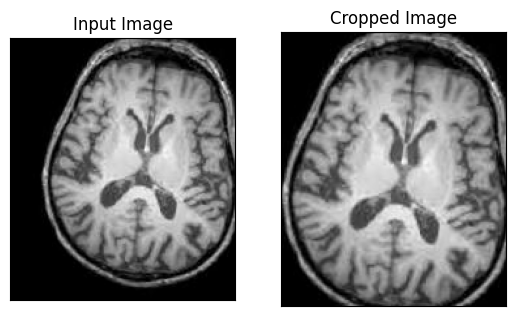

In [ ]:
example = cv2.imread(augmented_path+filename)
test = crop_image(example,plot=True)

## 2.4 Loading Data into Numpy Arrays X,y

Now, with the crop_image function defined, we are ready to crop and resize the image, and finally load our data into Numpy Arrays. 

The first array (X) will store the image, while the second array (y) will store the label.

In [ ]:
def load_data(list_of_dir,tuple_image_size,visualize=False):
  """
  Parameters:
    list_of_dir: takes in a list of directories where the input images are stored
    final_image_size: takes in a tuple of (width,height) of the desired image dimensions
    visualize: takes in boolean of whether to visualize the data
  """
  X = []
  y = []

  for dir in list_of_dir:
    for filename in listdir(dir):
      image = cv2.imread(dir+"/"+filename)
      image = crop_image(image,plot=False)
      image = cv2.resize(image, tuple_image_size, interpolation=cv2.INTER_CUBIC)
    
      image = image/255  ## standardize the values
      X.append(image)
      if dir[-6:] == "benign":
        y.append([0])
      else:
        y.append([1])
  X = np.array(X)
  y = np.array(y)
  
  ## using shuffle method from sklearn.utils
  X,y = shuffle(X,y)

  ## for debugging and visualizing purposes
  print(f"Total images loaded : {len(X)}")
  print(f"Shape of X : {X.shape}")
  print(f"Shape of y : {y.shape}")
  
  if visualize:
    for labels in [0,1]:
        to_plot = X[np.argwhere(y == labels)] [:4]
        col,row = 2,2
        plt.figure(figsize=(4,4))
        i =1
        for images in to_plot:
          plt.subplot(col,row,i)
          plt.imshow(images[0])
          plt.tick_params(axis='both', which='both', 
                            top=False, bottom=False, left=False, right=False,
                           labelbottom=False, labeltop=False, labelleft=False, labelright=False)
          i+= 1
        str_to_label = lambda labels: "Malignant" if labels == 1 else "Benign"
        plt.suptitle(f"Brain Tumor : {str_to_label(labels)}")
        plt.show()

  return X,y


Total images loaded : 1462
Shape of X : (1462, 125, 125, 3)
Shape of y : (1462, 1)


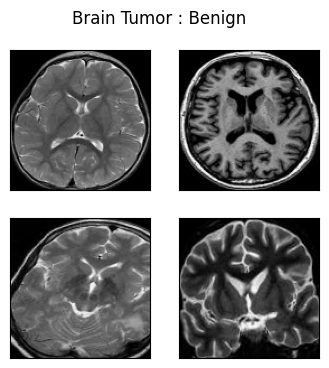

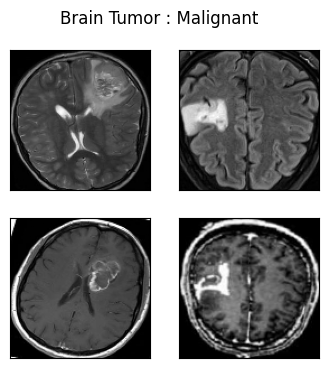

In [ ]:
img_width,img_height = (125,125)
list_of_dir = [augmented_path+"benign", augmented_path+"malignant"]
X,y = load_data(list_of_dir,(img_width,img_height),visualize=True)


For presentation purposes later on, we will define a similar function to the above, but only for 1 data and its label.


In [ ]:
# for presentation purposes 
def load_single_data(path, img_size):
    X = []
    y = []

    image = cv2.imread(path)
    image = crop_image(image,plot=False)
    image = cv2.resize(image, img_size, interpolation=cv2.INTER_CUBIC)
    image = image/255  ## standardize the values
    
    X.append(image)
    if "benign" in path:
      y.append([0])
    else:
      y.append([1])
    
    X = np.array(X)
    y = np.array(y)

    ## for debugging and visualizing purposes
    print(f"Shape of X : {X.shape}")
    print(f"Shape of y : {y.shape}")

    plt.figure()
    plt.imshow(image)
    
    str_to_label = lambda label: "Malignant" if label == 1 else "Benign"
    plt.suptitle(f"Brain Tumor : {str_to_label(y)}")
    plt.show()

    return X,y

## 2.5 Conversion of 4D datas into 2D datas



Some of the models that we will be using might not be able to handle 4 dimensions, which is the current representation of our datas. 

As such, we will create a function that provide a 2D version of the data that are converted from the 4D version.

In [ ]:
def convert_2D(X):
  n_sample, n_width,n_height,n_channels = X.shape
  X_2D = X.reshape((n_sample, n_width*n_height*n_channels))
  return X_2D

In [ ]:
X_2D = convert_2D(X)
print(f"New shape of X_2D is {X_2D.shape}")

New shape of X_2D is (1462, 46875)


## 2.6 Splitting into Train, Validation and Test Datas

We will split data into training data, validation data and test data, using 8:1:1 ratio of splitting.

In [ ]:
def split_data(X, y, test_size=0.2):  
    """
    Splits data into training, development and test sets.
    Arguments:
        X: A numpy array with shape = (#_examples, image_width, image_height, #_channels)
        y: A numpy array with shape = (#_examples, 1)
    Returns:
        X_train: A numpy array with shape = (#_train_examples, image_width, image_height, #_channels)
        y_train: A numpy array with shape = (#_train_examples, 1)
        X_val: A numpy array with shape = (#_val_examples, image_width, image_height, #_channels)
        y_val: A numpy array with shape = (#_val_examples, 1)
        X_test: A numpy array with shape = (#_test_examples, image_width, image_height, #_channels)
        y_test: A numpy array with shape = (#_test_examples, 1)
    """
    
    X_train, X_test_val, y_train, y_test_val = train_test_split(X, y, test_size=test_size, shuffle=True)
    X_test, X_val, y_test, y_val = train_test_split(X_test_val, y_test_val, test_size=0.5, shuffle=True)
    
    return X_train, y_train, X_val, y_val, X_test, y_test


In [ ]:
X_train, y_train, X_val, y_val, X_test, y_test = split_data(X, y, test_size=0.2)
print(f"number of training examples = {str(X_train.shape[0])}")
print(f"number of validation examples = {str(X_val.shape[0])}")
print(f"number of testing examples = {str(X_test.shape[0])}")

number of training examples = 1169
number of validation examples = 147
number of testing examples = 146


If any model requires the 2D version of the training/test/validation datas

In [ ]:
X_2D_train = convert_2D(X_train)
X_2D_val = convert_2D(X_val)
X_2D_test = convert_2D(X_test)

print(f"shape of 2D Training data = {X_2D_train.shape}")
print(f"shape of 2D Validation data = {X_2D_val.shape}")
print(f"shape of 2D Test data = {X_2D_test.shape}")

shape of 2D Training data = (1169, 46875)
shape of 2D Validation data = (147, 46875)
shape of 2D Test data = (146, 46875)


# 3. Various Models for Image Classification

In this section, we will explore 3 different models in Image Classification, namely:

1. Convolutional Neural Network (CNN)
2. Support Vector Machines (SVM)
3. Decision Trees

## 3.1 Pre-Defining Evaluation Function(s) 

We wish to firstly pre-define some function(s) that will enable us to utilize a specified evaluation metric and techniques on top of the standard methods.

### 3.1.1 Weighted Accuracy 

In our context of problem statement, we realize that **Type II errors** ("Malignant" tumors being classified "Benign") are relatively more deadly and expensive than **Type I errors** ("Benign" tumors being classified "Malignant").
 
With that understanding, we wish to search for evaluation metrics that take into account the ratio of importance/cost of False Negative(FN) against False Positive (FP). 

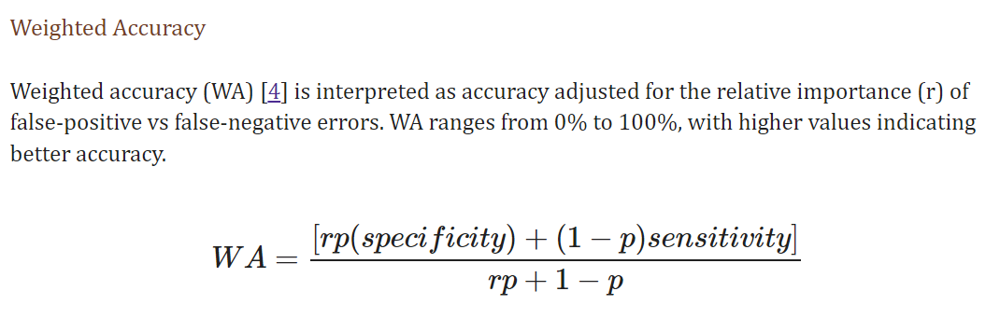

In [ ]:
def weighted_accuracy(relative_importance,prevalence_of_disease, y_true, y_predicted):
  """
  Parameters:
    relative_importance: takes in a fraction (0<x<1) that represents importance of False Negative (Type II error) 
                        against False Positive (Type I error). E.g. 0.25 would mean 1 False Negative costs equivalently
                        to 4 False Positive.
    prevalence_of_disease: takes in fraction (0<x<1) that represents prevalence of disease observed in population.
    y_true: takes in 1-d array-like of the actual labels
    y_predicted: takes in 1-d array-like of the predicted labels
  """

  ## Compute Confusion Matrix using sklearn.metrics.confusion_matrix
  tn, fp, fn, tp = confusion_matrix(y_true,y_predicted).ravel()
  
  ## Compute Specificity and Sensitivity
  spec = tn/(tn+fp)
  sens = tp/(tp+fn)

  r = relative_importance
  p = prevalence_of_disease

  ## compute weighted accuracy
  weighted_accuracy = (r*p*(spec)+ (1-p)*(sens))/(r*p + (1-p))
  return weighted_accuracy 


For some of the parameters, we will work with the assumption that FN errors are 4x more costly than FP errors.

Furthermore, we will quote the current statistics of prevalence of "malignant" tumors as 29.7% .

In [ ]:
relative_importance= 0.25
prevalence_of_disease= 0.297

### 3.1.2 Validation Technique: K-Cross Validation 

On top of the splitting in Part 2.6, we wish to utilize K-Fold technique in the training of our models, in hopes of observing the average performance of our models in different sets of trainings.

We will utilize KFold() function from sklearn to define our customized function to run the Cross Validation Techniques, save the pre-trained weights and saves the evaluation metrics for presentation.

In [ ]:
from sklearn.model_selection import KFold

def kfold(n, model_name, X_train_val, y_train_val, X_test, y_test, scores_dict): 
  kfold = KFold(n_splits = n)
  d = scores_dict

  count = 1 
  for train,val in kfold.split(X_train_val,  y_train_val):
    if model_name == "cnn":
      model = cnn()
      model.fit(x=X_train_val[train], y=y_train_val[train], batch_size = 32, epochs=12, validation_data = (X_train_val[val], y_train_val[val]))
      setwd("pretrained_model/cnn/train_" + str(count))
      model.save_weights("./k"+ str(count) + ".cpkt")
    elif model_name == "svm_cnn":
      model = svm_cnn()
      model.fit(x=X_train_val[train], y=y_train_val[train], batch_size = 32, epochs=12, validation_data = (X_train_val[val], y_train_val[val]))
      setwd("pretrained_model/svm_cnn/train_" + str(count))
      model.save_weights("./k"+ str(count) + ".cpkt")
    pred = model.predict(X_test, batch_size = 32, verbose = 1)
    y_pred = pred > 0.5
    count += 1 

    # storing evaluation metrics 
    report = classification_report(y_test, y_pred, output_dict = True)
    acc = weighted_accuracy(0.25, 0.297, y_test, y_pred)
    d['accuracy'] = np.append(d['accuracy'], report['accuracy'])
    d['precision'] = np.append(d['precision'], report['weighted avg']['precision'])
    d['recall'] = np.append(d['recall'], report['weighted avg']['recall'])
    d['f1-score'] = np.append(d['f1-score'], report['weighted avg']['f1-score'])
    d['weighted-accuracy'] = np.append(d['weighted-accuracy'], acc)

  return d 

### 3.1.3 Loading Pre-Trained Weights

If we have trained the model before, and save the pre-trained weights in our local directory, we can skip the training of the models, and load these weights for evaluation purposes.


In [ ]:
def load_cnn_weights(n,X_test, y_test, scores_dict):
  d = scores_dict
  for i in range(1,n+1):
    setwd("pretrained_model/cnn/train_"+str(i))
    files.upload()
    model = cnn()
    model.load_weights("./k" +str(i)+".cpkt")
    pred = model.predict(X_test, batch_size = 32, verbose = 1)
    y_pred = pred > 0.5
    report = classification_report(y_test, y_pred, output_dict = True)
    acc = weighted_accuracy(0.25, 0.297, y_test, y_pred)
    d['accuracy'] = np.append(d['accuracy'], report['accuracy'])
    d['precision'] = np.append(d['precision'], report['weighted avg']['precision'])
    d['recall'] = np.append(d['recall'], report['weighted avg']['recall'])
    d['f1-score'] = np.append(d['f1-score'], report['weighted avg']['f1-score'])
    d['weighted-accuracy'] = np.append(d['weighted-accuracy'], acc)
  return d


In [ ]:
def load_svm_cnn_weights(n,X_test, y_test, scores_dict):
  d = scores_dict
  for i in range(1,n+1):
    setwd("pretrained_model/svm_cnn/train_"+str(i))
    files.upload()
    model = cnn()
    model.load_weights("./k" +str(i)+".cpkt")
    pred = model.predict(X_test, batch_size = 32, verbose = 1)
    y_pred = pred > 0.5
    report = classification_report(y_test, y_pred, output_dict = True)
    acc = weighted_accuracy(0.25, 0.297, y_test, y_pred)
    d['accuracy'] = np.append(d['accuracy'], report['accuracy'])
    d['precision'] = np.append(d['precision'], report['weighted avg']['precision'])
    d['recall'] = np.append(d['recall'], report['weighted avg']['recall'])
    d['f1-score'] = np.append(d['f1-score'], report['weighted avg']['f1-score'])
    d['weighted-accuracy'] = np.append(d['weighted-accuracy'], acc)
  return d

## **3.2 Convolutional Neural Network (CNN)**

The first model uses Convolutional Neural Network because of its ability to detect patterns in images. Below is how our CNN algorithm works. 

**Step 1**: Initialize the Input Layer

**Step 2**: Using the Convolutional Layer 

The convolutional layer uses filter (kernel), which is a 7x7 matrix, that will slide (convolve) over each 7x7 set of pixels from the input until it slide over every 7x7 block of pixels from the entire image.

**Step 3**: MaxPooling 

Reduces the dimensionality of images by reducing the number of pixels in the output from previous convolutional layer. 

**Step 4**: Batch normalization 

We are trying to avoid instability in our neural networks that may cause imbalance gradients which lead to vanishing/exploding gradient problems by normalizing our data on the same scale. We normalize the output data from the activation functions for individual layers in batches. The batch normalization works by: 

1.   Normalize output from activation function (z = (x-mean)/sd))
2.   Multiply normalized output by arbitrary parameter (z*g)
3. Add arbitrary parameter to resulting product (z*g)+b 

The mean, sd, and the arbitrary parameters are trainable, which means they too will become optimized during the training process. 

**Step 5**: Repeat Step 2-4 

**Step 6**: Flattening and Densing 

After finishing the previous steps, now we should have pooled feature map. In this step, we woud like to flatten our pooled map into a column vector, that will be feed into dense layer to return the output. 


In [ ]:
#1 create the model
def cnn():
  X_shape = (125,125,3) 
  cnn = Sequential()  # create a pipeline 
  cnn.add(Input(X_shape))  # initialize input 

  # First convolutional layer 
  cnn.add(Conv2D(
      filters = 32, # how many filters we will learn
      kernel_size = (7, 7), # size of feature map that will slide over the image 
      strides = (1, 1), # how the feature map steps across the image
      padding = 'same', # using zero padding 
      activation = 'relu' # ReLu as the activation function 
  ))
  cnn.add(MaxPooling2D(
      pool_size = (4,4)
  ))
  cnn.add(BatchNormalization(
      axis = 1
  ))

  # Second convolutional layer 
  cnn.add(Conv2D(
      filters = 64, # how many filters we will learn
      kernel_size = (3, 3), # size of feature map that will slide over the image
      strides = (1, 1), # how the feature map steps across the image
      padding = 'same', # using zero padding 
      activation = 'relu' # ReLu as the activation function 
  ))
  cnn.add(MaxPooling2D(
      pool_size = (4,4)
  ))
  cnn.add(BatchNormalization(
      axis = 1
  ))

  # Output from previous layer is a 3D tensor. This must be flattened to a 1D 
  # vector before being fed to the Dense layer. 
  cnn.add(Flatten())
  cnn.add(Dense(
      units = 1, 
      activation = "sigmoid"
  ))

  cnn.compile(optimizer='adam', 
                   loss='binary_crossentropy', 
                   metrics=['accuracy'])
  return cnn 

### 3.2.1 Compiling the model without Pre-trained model

In [ ]:
# 2 run the model: compile and fit our data 
cnn_model = cnn()
cnn_model.summary()

cnn_hist = cnn_model.fit(x=X_train, y=y_train, 
               batch_size=32, epochs=12, validation_data = (X_val, y_val)) 


Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_18 (Conv2D)          (None, 125, 125, 32)      4736      
                                                                 
 max_pooling2d_18 (MaxPoolin  (None, 31, 31, 32)       0         
 g2D)                                                            
                                                                 
 batch_normalization_18 (Bat  (None, 31, 31, 32)       124       
 chNormalization)                                                
                                                                 
 conv2d_19 (Conv2D)          (None, 31, 31, 64)        18496     
                                                                 
 max_pooling2d_19 (MaxPoolin  (None, 7, 7, 64)         0         
 g2D)                                                            
                                                      

After training, we wish to save the pre-trained weights into our local directory, such that we can run the models without needing to retrain all over again.

In [ ]:
# saving the weights of pretrained models 
setwd("pretrained_model/cnn/train_0")
cnn_model.save_weights("./cp.cpkt")

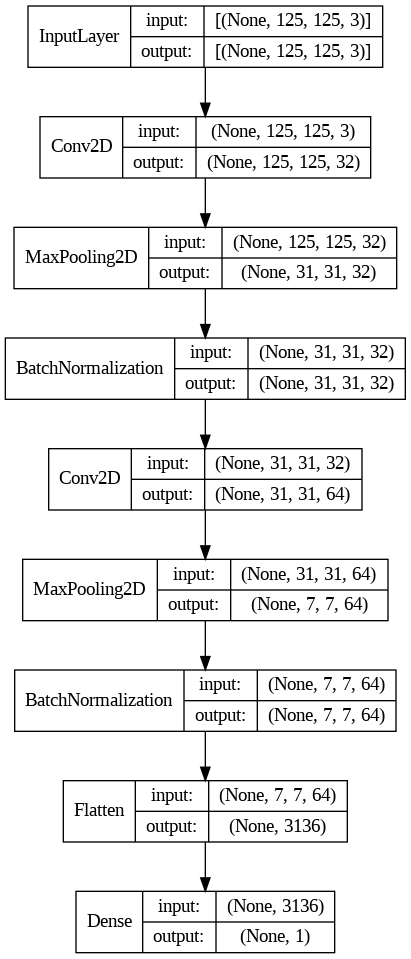

In [ ]:
plot_model(cnn_model, to_file="cnn_model.png", show_shapes = True, show_layer_names = False)

Using the history object from our training, we can also visualize how our first training model's history of training and validation accuracy and losses.

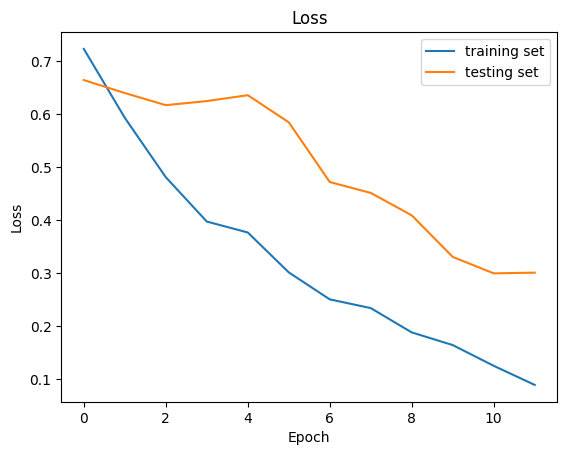

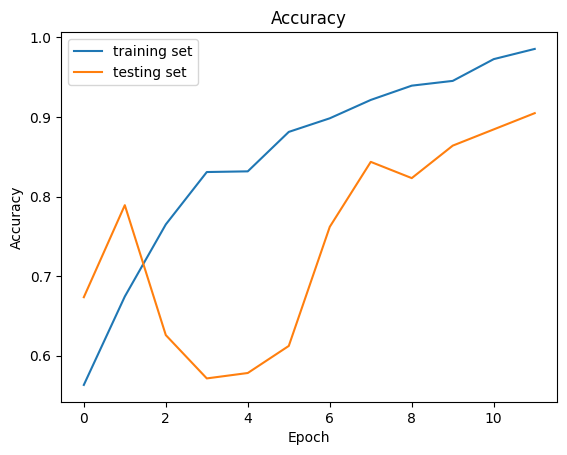

In [ ]:
# History for loss

# START CODE HERE
hist = cnn_hist.history
train_loss = hist['loss']
test_loss = hist['val_loss']
train_acc = hist['accuracy']
test_acc = hist['val_accuracy']

plt.figure()
plt.plot(train_loss, label = 'training set')
plt.plot(test_loss, label = 'testing set')
plt.title('Loss')
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend()
# END CODE HERE
plt.show()


# History for accuracy

# START CODE HERE
plt.figure()
plt.plot(train_acc, label = 'training set')
plt.plot(test_acc, label = 'testing set')
plt.title('Accuracy')
plt.xlabel("Epoch")
plt.ylabel("Accuracy")
plt.legend()
# END CODE HERE
plt.show()

In [ ]:
# 3: create prediction for the test data 
setwd("pretrained_model/cnn/train_0")
cnn_model = cnn()
cnn_model.load_weights('./cp.cpkt')
# loss, acc = cnn_model.evaluate(X_test, y_test)
# print(f"CNN Model, loss: {np.round(loss*100,3)}%, accuracy: {np.round(acc*100,3)}%")

cnn_pred = cnn_model.predict(X_test, batch_size = 32, verbose = 1)
cnn_y_pred = cnn_pred > 0.5

# 4: evaluation 
print("CNN (with 2 Conv Layers) Evaluation Report")
cnn_metrics = classification_report(y_test, cnn_y_pred, output_dict = True)
print(classification_report(y_test, cnn_y_pred))
relative_importance = 0.25
prevalence_of_disease = 0.297 
acc = weighted_accuracy(relative_importance,prevalence_of_disease, y_test, cnn_y_pred)
print(f"Weighted Accuracy is {np.round(acc*100,3)} %" )

5/5 [==============================] - 2s 316ms/step
CNN (with 2 Conv Layers) Evaluation Report
              precision    recall  f1-score   support

           0       0.85      0.90      0.88        78
           1       0.88      0.82      0.85        68

    accuracy                           0.86       146
   macro avg       0.86      0.86      0.86       146
weighted avg       0.86      0.86      0.86       146

Weighted Accuracy is 83.059 %


Shape of X : (1, 125, 125, 3)
Shape of y : (1, 1)


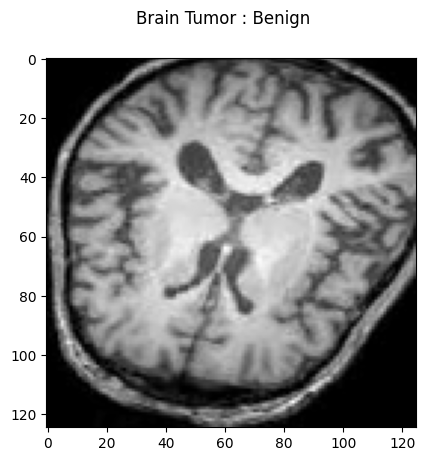

1/1 [==============================] - 0s 46ms/step

 According to our model, the image shown is benign 

Shape of X : (1, 125, 125, 3)
Shape of y : (1, 1)


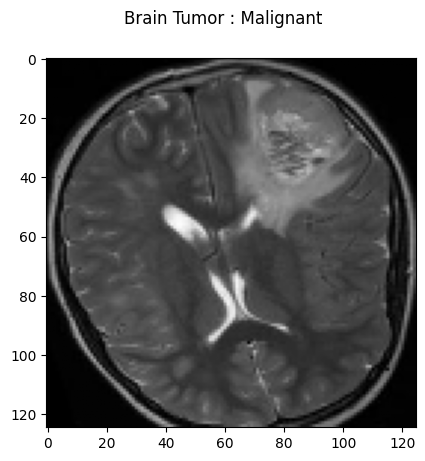

1/1 [==============================] - 0s 49ms/step

 According to our model, the image shown is malignant 



In [ ]:
# 5: Check the prediction of our model
setwd("data")
test1 = load_single_data(augmented_path+"benign/aug_10_0_1424.jpg", (125,125))
print(f"\n According to our model, the image shown is {np.where(cnn_model.predict(test1[0]) > 0.5, 'malignant', 'benign')[0][0]} \n")

test2 = load_single_data(augmented_path+"malignant/aug_100_0_1023.jpg", (125,125))
print(f"\n According to our model, the image shown is {np.where(cnn_model.predict(test2[0]) > 0.5, 'malignant', 'benign')[0][0]} \n")

In [ ]:
# 6: k-cross validation 
scores = {}
scores['accuracy'], scores['precision'], scores['recall'], scores['f1-score'], scores['weighted-accuracy'] = np.array([]), np.array([]), np.array([]), np.array([]), np.array([])
X_train_val = np.concatenate((X_train, X_val), axis=0)
y_train_val = np.concatenate((y_train, y_val), axis=0)
print(f"Shape of X_train + X_val = {X_train_val.shape}")
print(f"Shape of y_train + y_val = {y_train_val.shape}")
print(f"Shape of X_test = {X_test.shape}")
print(f"Shape of y_test = {y_test.shape}")

cnn_kfold = kfold(5, "cnn", X_train_val, y_train_val, X_test, y_test, scores)

Shape of X_train + X_val = (1317, 125, 125, 3)
Shape of y_train + y_val = (1317, 1)
Shape of X_test = (146, 125, 125, 3)
Shape of y_test = (146, 1)
Epoch 1/12
33/33 [==============================] - 36s 1s/step - loss: 0.7715 - accuracy: 0.5613 - val_loss: 0.6752 - val_accuracy: 0.5492
Epoch 2/12
33/33 [==============================] - 31s 945ms/step - loss: 0.6201 - accuracy: 0.6515 - val_loss: 0.6594 - val_accuracy: 0.6023
Epoch 3/12
33/33 [==============================] - 33s 997ms/step - loss: 0.5560 - accuracy: 0.7085 - val_loss: 0.6748 - val_accuracy: 0.5341
Epoch 4/12
33/33 [==============================] - 30s 915ms/step - loss: 0.4741 - accuracy: 0.7749 - val_loss: 0.6349 - val_accuracy: 0.5947
Epoch 5/12
33/33 [==============================] - 33s 1s/step - loss: 0.4015 - accuracy: 0.8234 - val_loss: 0.6855 - val_accuracy: 0.5492
Epoch 6/12
33/33 [==============================] - 31s 932ms/step - loss: 0.3438 - accuracy: 0.8443 - val_loss: 0.6142 - val_accuracy: 0.6098


### 3.2.2 Compiling the model with Pre-trained model


If we have pre-trained weights loaded into the model, we can, instead, use the following function to evaluate our models.

In [ ]:
scores = {}
scores['accuracy'], scores['precision'], scores['recall'], scores['f1-score'], scores['weighted-accuracy'] = np.array([]), np.array([]), np.array([]), np.array([]), np.array([])
cnn_kfold = load_cnn_weights(5,X_test,y_test,scores)

/content/pretrained_model/cnn/train_1 succesfully created.


Saving checkpoint to checkpoint
Saving k1.cpkt.data-00000-of-00001 to k1.cpkt.data-00000-of-00001
Saving k1.cpkt.index to k1.cpkt.index
5/5 [==============================] - 2s 237ms/step
/content/pretrained_model/cnn/train_2 succesfully created.


Saving checkpoint to checkpoint
Saving k2.cpkt.data-00000-of-00001 to k2.cpkt.data-00000-of-00001
Saving k2.cpkt.index to k2.cpkt.index
5/5 [==============================] - 2s 320ms/step
/content/pretrained_model/cnn/train_3 succesfully created.


Saving checkpoint to checkpoint
Saving k3.cpkt.data-00000-of-00001 to k3.cpkt.data-00000-of-00001
Saving k3.cpkt.index to k3.cpkt.index
5/5 [==============================] - 1s 235ms/step
/content/pretrained_model/cnn/train_4 succesfully created.


Saving checkpoint to checkpoint
Saving k4.cpkt.data-00000-of-00001 to k4.cpkt.data-00000-of-00001
Saving k4.cpkt.index to k4.cpkt.index
5/5 [==============================] - 1s 233ms/step
/content/pretrained_model/cnn/train_5 succesfully created.


Saving checkpoint to checkpoint
Saving k5.cpkt.data-00000-of-00001 to k5.cpkt.data-00000-of-00001
Saving k5.cpkt.index to k5.cpkt.index
5/5 [==============================] - 1s 236ms/step


### 3.2.3 Summary of CNN's performance

In [ ]:
print("CNN 5-Fold Cross Validation")
print("Accuracy: ", cnn_kfold['accuracy'])
print(f"Average accuracy: {np.round(np.mean(cnn_kfold['accuracy']), 3)*100}% \n")

print("Precision: ", cnn_kfold['precision'])
print(f"Average precision: {np.round(np.mean(cnn_kfold['precision']), 3)*100}% \n")

print("Recall: ", cnn_kfold['recall'])
print(f"Average recall: {np.round(np.mean(cnn_kfold['recall']), 3)*100}% \n")

print("f1-score: ", cnn_kfold['f1-score'])
print(f"Average accuracy: {np.round(np.mean(cnn_kfold['f1-score']), 3)*100}% \n")

print("weighted-accuracy: ", cnn_kfold['weighted-accuracy'])
print(f"Average weighted-accuracy: {np.round(np.mean(cnn_kfold['weighted-accuracy']), 3)*100}% \n")

CNN 5-Fold Cross Validation
Accuracy:  [0.86986301 0.79452055 0.80821918 0.80136986 0.78767123]
Average accuracy: 81.2% 

Precision:  [0.86943901 0.793163   0.80705869 0.81456772 0.79513523]
Average precision: 81.6% 

Recall:  [0.86986301 0.79452055 0.80821918 0.80136986 0.78767123]
Average recall: 81.2% 

f1-score:  [0.86926843 0.7932244  0.80700944 0.79208653 0.77925117]
Average accuracy: 80.80000000000001% 

weighted-accuracy:  [0.89901975 0.83732384 0.8493392  0.90915962 0.88836718]
Average weighted-accuracy: 87.7% 



In [ ]:
# Specify the Column Names while initializing the Table 
columns = ["K-Fold","Accuracy", "Precision", "Recall", "F1-Score", "Weighted Accuracy"] 
cnn_kfold_table = PrettyTable() 
# Add rows 
cnn_kfold_table.add_column(columns[0], [1,2,3,4,5]) 
cnn_kfold_table.add_column(columns[1], np.round(np.multiply(cnn_kfold['accuracy'],100),3)) 
cnn_kfold_table.add_column(columns[2], np.round(np.multiply(cnn_kfold['precision'],100),3)) 
cnn_kfold_table.add_column(columns[3], np.round(np.multiply(cnn_kfold['recall'],100),3)) 
cnn_kfold_table.add_column(columns[4], np.round(np.multiply(cnn_kfold['f1-score'],100),3)) 
cnn_kfold_table.add_column(columns[5], np.round(np.multiply(cnn_kfold['weighted-accuracy'],100),3)) 
 
cnn_kfold_table.add_row(["Average", 
                        np.mean(np.round(np.multiply(cnn_kfold['accuracy'],100),3)), 
                        np.mean(np.round(np.multiply(cnn_kfold['precision'],100),3)), 
                        np.mean(np.round(np.multiply(cnn_kfold['recall'],100),3)), 
                        np.mean(np.round(np.multiply(cnn_kfold['f1-score'],100),3)), 
                        np.mean(np.round(np.multiply(cnn_kfold['weighted-accuracy'],100),3))]) 
 
 
print(cnn_kfold_table)

+---------+----------+-----------+---------+----------+-------------------+
|  K-Fold | Accuracy | Precision |  Recall | F1-Score | Weighted Accuracy |
+---------+----------+-----------+---------+----------+-------------------+
|    1    |  86.986  |   86.944  |  86.986 |  86.927  |       89.902      |
|    2    |  79.452  |   79.316  |  79.452 |  79.322  |       83.732      |
|    3    |  80.822  |   80.706  |  80.822 |  80.701  |       84.934      |
|    4    |  80.137  |   81.457  |  80.137 |  79.209  |       90.916      |
|    5    |  78.767  |   79.514  |  78.767 |  77.925  |       88.837      |
| Average | 81.2328  |  81.5874  | 81.2328 | 80.8168  |      87.6642      |
+---------+----------+-----------+---------+----------+-------------------+


## 3.3 Support Vector Machines (SVM) 

Another hyperparameter tuning in how we train our datas is to adapt the **Support Vector Machines (SVM) classifier**. 

SVM builds a hyperplane in multidimensional space to differentiate categorical variables. In training, it will continue to improve the parameters of the hyperplane based on the loss functions, aiming to achieve minimum error.

In this model, we will explore the implementations
of Hybrid SVM-CNN Model.

We want to implement the feature extraction similar to the CNN Model, however, a slight hyperparameter tuning that we utilize here is the use of SVM to classify the classes (as compared to using sigmoid functions in CNN)

We will be using **l2 regularization** which minimizes its loss function depending on the sum of the squared of the weights, which also helps to tackle the exploding gradient problem. 

In [ ]:
def svm_cnn():
  X_shape = (125,125,3) 
  svm_cnn = Sequential()  # create a pipeline 
  svm_cnn.add(Input(X_shape))  # initialize input 

  # First convolutional layer 
  svm_cnn.add(Conv2D(
      filters = 32, # how many filters we will learn
      kernel_size = (7, 7), # size of feature map that will slide over the image 
      strides = (1, 1), # how the feature map steps across the image
      padding = 'same', # using zero padding 
      activation = 'relu' # ReLu as the activation function 
  ))
  svm_cnn.add(MaxPooling2D(
      pool_size = (4,4)
  ))
  svm_cnn.add(BatchNormalization(
      axis = 1
  ))

  # Second convolutional layer 
  svm_cnn.add(Conv2D(
      filters = 64, # how many filters we will learn
      kernel_size = (3, 3), # size of feature map that will slide over the image
      strides = (1, 1), # how the feature map steps across the image
      padding = 'same', # using zero padding 
      activation = 'relu' # ReLu as the activation function 
  ))
  svm_cnn.add(MaxPooling2D(
      pool_size = (4,4)
  ))
  svm_cnn.add(BatchNormalization(
      axis = 1
  ))

  # Output from previous layer is a 3D tensor. This must be flattened to a 1D 
  # vector before being fed to the Dense layer. 
  svm_cnn.add(Flatten())

  ## The difference with the CNN model is that for the output layer, we want to utilize the l2 regularizer in minimizing its loss function
  ## depends on the sum of the squared of the weights. 
  svm_cnn.add(Dense(1, kernel_regularizer=l2(0.01), activation ="linear"))

  svm_cnn.compile(optimizer='adam', 
                   loss='hinge', 
                   metrics=['accuracy'])
  return svm_cnn 

### 3.3.1 Compiling the model without Pre-trained model

In [ ]:
# 2 run the model: compile and fit our data 
svm_cnn_model = svm_cnn()
svm_cnn_model.summary()
svm_cnn_hist = svm_cnn_model.fit(x=X_train, y=y_train, 
               batch_size=32, epochs=12, validation_data = (X_val, y_val)) 

# saving the weights of pretrained models 
setwd("pretrained_model/svm_cnn/train_0")
svm_cnn_model.save_weights("./cp.cpkt")

Model: "sequential_19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_38 (Conv2D)          (None, 125, 125, 32)      4736      
                                                                 
 max_pooling2d_38 (MaxPoolin  (None, 31, 31, 32)       0         
 g2D)                                                            
                                                                 
 batch_normalization_38 (Bat  (None, 31, 31, 32)       124       
 chNormalization)                                                
                                                                 
 conv2d_39 (Conv2D)          (None, 31, 31, 64)        18496     
                                                                 
 max_pooling2d_39 (MaxPoolin  (None, 7, 7, 64)         0         
 g2D)                                                            
                                                     

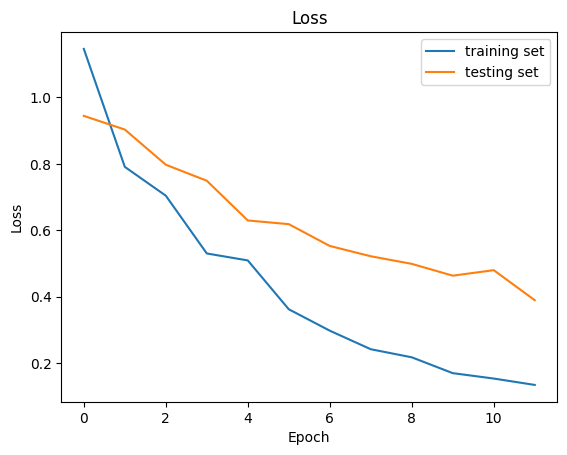

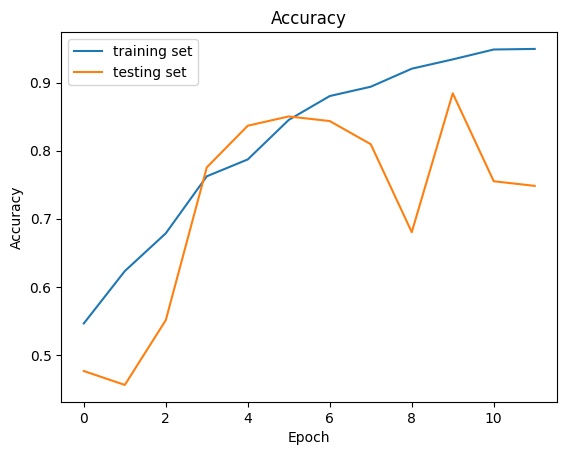

In [ ]:
# History for loss

# START CODE HERE
hist = svm_cnn_hist.history
train_loss = hist['loss']
test_loss = hist['val_loss']
train_acc = hist['accuracy']
test_acc = hist['val_accuracy']

plt.figure()
plt.plot(train_loss, label = 'training set')
plt.plot(test_loss, label = 'testing set')
plt.title('Loss')
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend()
# END CODE HERE
plt.show()


# History for accuracy

# START CODE HERE
plt.figure()
plt.plot(train_acc, label = 'training set')
plt.plot(test_acc, label = 'testing set')
plt.title('Accuracy')
plt.xlabel("Epoch")
plt.ylabel("Accuracy")
plt.legend()
# END CODE HERE
plt.show()

In [ ]:
# 3: create prediction for the test data 
setwd("pretrained_model/svm_cnn/train_0")
svm_cnn_model = svm_cnn()
svm_cnn_model.load_weights('./cp.cpkt')

svm_cnn_pred = svm_cnn_model.predict(X_test, batch_size = 32, verbose = 1)
svm_cnn_y_pred = svm_cnn_pred > 0.5

# 4: evaluation 
print("SVM CNN Evaluation Report")
svm_cnn_metrics = classification_report(y_test, svm_cnn_y_pred, output_dict = True)
print(classification_report(y_test, svm_cnn_y_pred))
relative_importance = 0.25
prevalence_of_disease = 0.297 
acc = weighted_accuracy(relative_importance,prevalence_of_disease, y_test, svm_cnn_y_pred)
print(f"Weighted Accuracy is {np.round(acc*100,3)} %" )

5/5 [==============================] - 1s 214ms/step
SVM CNN Evaluation Report
              precision    recall  f1-score   support

           0       0.81      0.99      0.89        78
           1       0.98      0.74      0.84        68

    accuracy                           0.87       146
   macro avg       0.90      0.86      0.87       146
weighted avg       0.89      0.87      0.87       146

Weighted Accuracy is 75.936 %


In [ ]:
scores = {}
scores['accuracy'], scores['precision'], scores['recall'], scores['f1-score'], scores['weighted-accuracy'] = np.array([]), np.array([]), np.array([]), np.array([]), np.array([])
X_train_val = np.concatenate((X_train, X_val), axis=0)
y_train_val = np.concatenate((y_train, y_val), axis=0)
print(f"Shape of X_train + X_val = {X_train_val.shape}")
print(f"Shape of y_train + y_val = {y_train_val.shape}")
print(f"Shape of X_test = {X_test.shape}")
print(f"Shape of y_test = {y_test.shape}")

svm_cnn_kfold = kfold(5, "svm_cnn",  X_train_val, y_train_val, X_test, y_test, scores)

Shape of X_train + X_val = (1317, 125, 125, 3)
Shape of y_train + y_val = (1317, 1)
Shape of X_test = (146, 125, 125, 3)
Shape of y_test = (146, 1)
Epoch 1/12
33/33 [==============================] - 43s 1s/step - loss: 1.0023 - accuracy: 0.5480 - val_loss: 0.9864 - val_accuracy: 0.4735
Epoch 2/12
33/33 [==============================] - 33s 1s/step - loss: 0.7418 - accuracy: 0.6600 - val_loss: 0.8952 - val_accuracy: 0.6629
Epoch 3/12
33/33 [==============================] - 33s 986ms/step - loss: 0.5459 - accuracy: 0.7607 - val_loss: 0.8709 - val_accuracy: 0.6780
Epoch 4/12
33/33 [==============================] - 30s 911ms/step - loss: 0.4417 - accuracy: 0.8091 - val_loss: 0.8490 - val_accuracy: 0.6477
Epoch 5/12
33/33 [==============================] - 32s 964ms/step - loss: 0.3940 - accuracy: 0.8234 - val_loss: 0.7925 - val_accuracy: 0.7500
Epoch 6/12
33/33 [==============================] - 31s 946ms/step - loss: 0.3444 - accuracy: 0.8528 - val_loss: 0.8393 - val_accuracy: 0.6780


### 3.3.2 Compiling the model with Pre-trained model

If we have pre-trained weights loaded into the model, we can, instead, use the following function to evaluate our models.

In [ ]:
scores = {}
scores['accuracy'], scores['precision'], scores['recall'], scores['f1-score'], scores['weighted-accuracy'] = np.array([]), np.array([]), np.array([]), np.array([]), np.array([])
svm_cnn_kfold = load_svm_cnn_weights(5,X_test,y_test,scores)

/content/pretrained_model/svm_cnn/train_1 succesfully created.


Saving checkpoint to checkpoint
Saving k1.cpkt.data-00000-of-00001 to k1.cpkt.data-00000-of-00001
Saving k1.cpkt.index to k1.cpkt.index
5/5 [==============================] - 2s 305ms/step
/content/pretrained_model/svm_cnn/train_2 succesfully created.


Saving checkpoint to checkpoint
Saving k2.cpkt.data-00000-of-00001 to k2.cpkt.data-00000-of-00001
Saving k2.cpkt.index to k2.cpkt.index
5/5 [==============================] - 1s 229ms/step
/content/pretrained_model/svm_cnn/train_3 succesfully created.


Saving checkpoint to checkpoint
Saving k3.cpkt.data-00000-of-00001 to k3.cpkt.data-00000-of-00001
Saving k3.cpkt.index to k3.cpkt.index
5/5 [==============================] - 2s 273ms/step
/content/pretrained_model/svm_cnn/train_4 succesfully created.


Saving checkpoint to checkpoint
Saving k4.cpkt.data-00000-of-00001 to k4.cpkt.data-00000-of-00001
Saving k4.cpkt.index to k4.cpkt.index
5/5 [==============================] - 1s 229ms/step
/content/pretrained_model/svm_cnn/train_5 succesfully created.


Saving checkpoint to checkpoint
Saving k5.cpkt.data-00000-of-00001 to k5.cpkt.data-00000-of-00001
Saving k5.cpkt.index to k5.cpkt.index
5/5 [==============================] - 2s 308ms/step


### 3.3.3 Summary of SVM's performance

In [ ]:
print("SVM CNN 5-Fold Cross Validation")
print("Accuracy: ", svm_cnn_kfold['accuracy'])
print(f"Average accuracy: {np.round(np.mean(svm_cnn_kfold['accuracy']), 3)*100}% \n")

print("Precision: ", svm_cnn_kfold['precision'])
print(f"Average precision: {np.round(np.mean(svm_cnn_kfold['precision']), 3)*100}% \n")

print("Recall: ", svm_cnn_kfold['recall'])
print(f"Average recall: {np.round(np.mean(svm_cnn_kfold['recall']), 3)*100}% \n")

print("f1-score: ", svm_cnn_kfold['f1-score'])
print(f"Average accuracy: {np.round(np.mean(svm_cnn_kfold['f1-score']), 3)*100}% \n")

print("weighted-accuracy: ", svm_cnn_kfold['weighted-accuracy'])
print(f"Average weighted-accuracy: {np.round(np.mean(svm_cnn_kfold['weighted-accuracy']), 3)*100}% \n")

SVM CNN 5-Fold Cross Validation
Accuracy:  [0.74657534 0.81506849 0.80136986 0.80136986 0.81506849]
Average accuracy: 79.60000000000001% 

Precision:  [0.76375259 0.81409002 0.81456772 0.80025277 0.81404827]
Average precision: 80.10000000000001% 

Recall:  [0.74657534 0.81506849 0.80136986 0.80136986 0.81506849]
Average recall: 79.60000000000001% 

f1-score:  [0.72843152 0.81422356 0.79208653 0.80046234 0.81355993]
Average accuracy: 79.0% 

weighted-accuracy:  [0.88742944 0.85095833 0.90915962 0.83894298 0.85973541]
Average weighted-accuracy: 86.9% 



In [ ]:
# Specify the Column Names while initializing the Table 
columns = ["K-Fold","Accuracy", "Precision", "Recall", "F1-Score", "Weighted Accuracy"] 
svm_cnn_kfold_table = PrettyTable() 
# Add rows 
svm_cnn_kfold_table.add_column(columns[0], [1,2,3,4,5]) 
svm_cnn_kfold_table.add_column(columns[1], np.round(np.multiply(svm_cnn_kfold['accuracy'],100),3)) 
svm_cnn_kfold_table.add_column(columns[2], np.round(np.multiply(svm_cnn_kfold['precision'],100),3)) 
svm_cnn_kfold_table.add_column(columns[3], np.round(np.multiply(svm_cnn_kfold['recall'],100),3)) 
svm_cnn_kfold_table.add_column(columns[4], np.round(np.multiply(svm_cnn_kfold['f1-score'],100),3)) 
svm_cnn_kfold_table.add_column(columns[5], np.round(np.multiply(svm_cnn_kfold['weighted-accuracy'],100),3)) 
 
svm_cnn_kfold_table.add_row(["Average", 
                        np.mean(np.round(np.multiply(svm_cnn_kfold['accuracy'],100),3)), 
                        np.mean(np.round(np.multiply(svm_cnn_kfold['precision'],100),3)), 
                        np.mean(np.round(np.multiply(svm_cnn_kfold['recall'],100),3)), 
                        np.mean(np.round(np.multiply(svm_cnn_kfold['f1-score'],100),3)), 
                        np.mean(np.round(np.multiply(svm_cnn_kfold['weighted-accuracy'],100),3))]) 
 
 
print(svm_cnn_kfold_table)

+---------+----------+-------------------+---------+----------+-------------------+
|  K-Fold | Accuracy |     Precision     |  Recall | F1-Score | Weighted Accuracy |
+---------+----------+-------------------+---------+----------+-------------------+
|    1    |  74.658  |       76.375      |  74.658 |  72.843  |       88.743      |
|    2    |  81.507  |       81.409      |  81.507 |  81.422  |       85.096      |
|    3    |  80.137  |       81.457      |  80.137 |  79.209  |       90.916      |
|    4    |  80.137  |       80.025      |  80.137 |  80.046  |       83.894      |
|    5    |  81.507  |       81.405      |  81.507 |  81.356  |       85.974      |
| Average | 79.5892  | 80.13419999999999 | 79.5892 | 78.9752  |      86.9246      |
+---------+----------+-------------------+---------+----------+-------------------+


## 3.4 Decision Trees

Appending X_2D_test and X_2D_val as cross-validation is done in GridSearchCV, then checking the shape of appended x_2D_val to x_2D_train

In [ ]:
X_2D_train_copy = np.copy(X_2D_train)
X_2D_val_copy = np.copy(X_2D_val)
X_2D_trainval = np.append(X_2D_train_copy, X_2D_val_copy, axis = 0)
np.shape(X_2D_trainval)

(1316, 46875)

Checking the shape of appended y_val to y_train

In [ ]:
y_train_copy = np.copy(y_train)
y_val_copy = np.copy(y_val)
y_trainval = np.append(y_train, y_val)
np.shape(y_trainval)

(1316,)

Hyperparameter tuning

Here are some of the hyperparameters that we decided to tune:

*   criterion

This determines how to split the data at each node. We chose "gini" and "entropy" as they are the most commonly used criteria in decision trees. This is because they are effective, computationally efficient, and can be used in a wide range of scenarios.

*   splitter

This determines  how to divide the data at each node. “best” chooses the best split while “random” chooses the best random split.

*   max_depth

This is the maximum depth that we allow the tree to grow to. Deeper trees make more complex models, and generally will decrease the training error. However, if the tree grows too deep, it can cause overfitting & increase in testing error. Conversely, if the tree is too shallow, it might be too inflexible to capture the patterns and interaction in the training data.

*   min_samples_split

This is the minimum number of samples required to be in a node, for the node to qualify to being split. to splits an internal code. their various values that we can enter for this hyperparameter we can either specify an integer or a number to denote the minimum number of samples we want to an internal node or a fraction in an internal node is used to denote the percentage of samples.

In [ ]:
#1 create the model
hyperparameters = {'criterion': ['gini', 'entropy'],
     'splitter': ['best', 'random'],
     'max_depth': [2*n for n in range(1,3)],
     'min_samples_split': [2, 5, 10]} #the smaller, the higher risk of overfitting

tree = DecisionTreeClassifier()
tree_cv = GridSearchCV(tree, hyperparameters, cv=5) #5-fold cross validation

In [ ]:
# 2 run the model: compile and fit our data 
tree_hist = tree_cv.fit(X_2D_trainval,y_trainval)


In [ ]:
print("Tuned Hyperparameters")
best_params = tree_cv.best_params_
for key, value in best_params.items():
  print(f'{key} : {value}')

print(f"\nAccuracy : {np.round(tree_cv.best_score_,3)*100} %")

Tuned Hyperparameters
criterion : gini
max_depth : 4
min_samples_split : 10
splitter : random

Accuracy : 65.7 %


In [ ]:
# 3: create prediction for the test data 
tree_pred = tree_cv.predict(X_2D_test)
tree_pred

array([1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1,
       0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0,
       0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0,
       1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1,
       1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0,
       1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0])

In [ ]:
# 4: evaluation 
print("Decision Tree Evaluation Report")
tree_metrics = classification_report(y_test, tree_pred, output_dict = True)
print(classification_report(y_test, tree_pred))

relative_importance = 0.25
prevalence_of_disease = 0.297 
acc = weighted_accuracy(relative_importance,prevalence_of_disease, y_test, tree_pred)
print(f"Weighted Accuracy is {np.round(acc*100,3)} %" )

Decision Tree Evaluation Report
              precision    recall  f1-score   support

           0       0.53      0.71      0.60        59
           1       0.74      0.56      0.64        87

    accuracy                           0.62       146
   macro avg       0.63      0.64      0.62       146
weighted avg       0.65      0.62      0.63       146

Weighted Accuracy is 57.742 %


Visualising the first 2 splits in the decision tree.

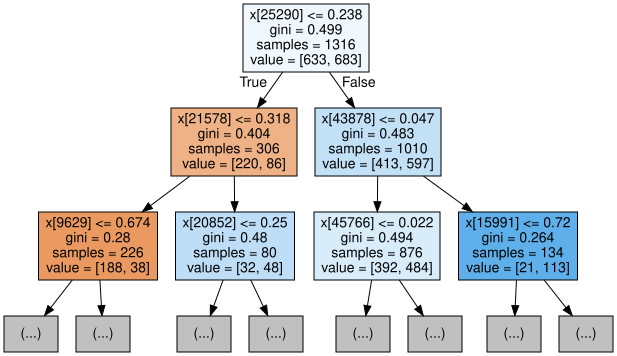

In [ ]:
import graphviz
# DOT data
dot_data = export_graphviz(tree_cv.best_estimator_,filled=True,max_depth=2)

# Draw graph
graph = graphviz.Source(dot_data, format="png") 
graph

# 4. Model Evaluation Metrics

In order to easily analyze and compare the performance of those three methods, we created a comparison plot.

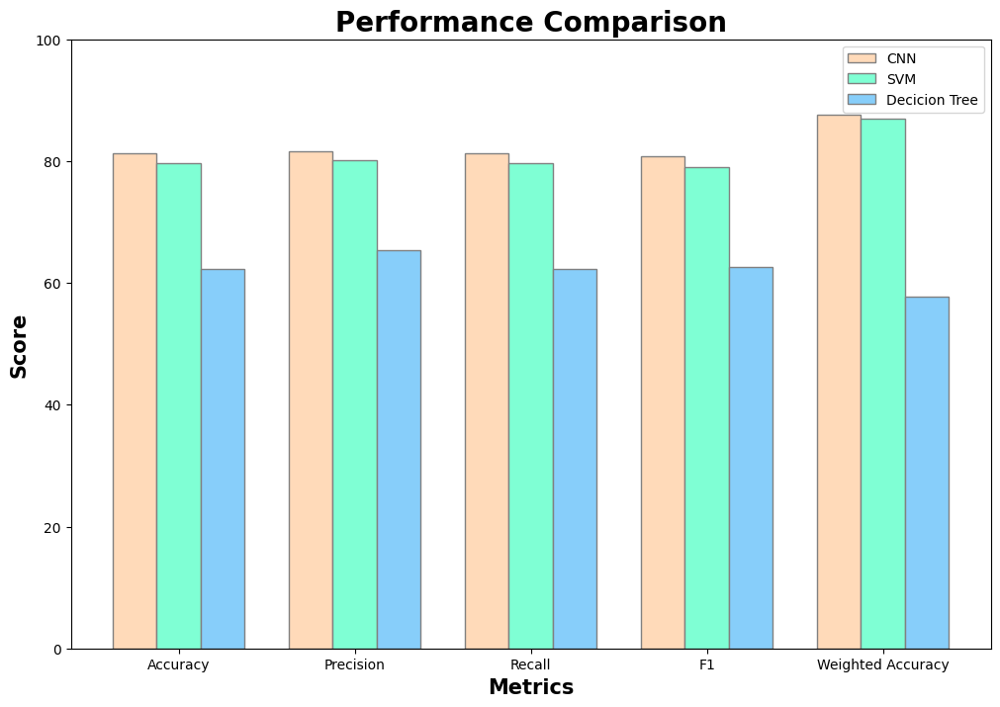

In [ ]:
## Code for the plot 

# seting the width of the bars 
barWidth = 0.25 
fig = plt.subplots(figsize =(12, 8)) 
 
# setting the height of the bars 
cnn = np.asarray([np.mean(cnn_kfold['accuracy']),  
                  np.mean(cnn_kfold['precision']),  
                  np.mean(cnn_kfold['recall']),  
                  np.mean(cnn_kfold['f1-score']),  
                  np.mean(cnn_kfold['weighted-accuracy'])]) 
 
svm = np.asarray([np.mean(svm_cnn_kfold['accuracy']),  
                  np.mean(svm_cnn_kfold['precision']),  
                  np.mean(svm_cnn_kfold['recall']),  
                  np.mean(svm_cnn_kfold['f1-score']),  
                  np.mean(svm_cnn_kfold['weighted-accuracy'])]) 
 
dt = np.asarray([tree_metrics['accuracy'],  
                 tree_metrics['weighted avg']['precision'],  
                 tree_metrics['weighted avg']['recall'],  
                 tree_metrics['weighted avg']['f1-score'],  
                 acc]) 
 
cnn, svm, dt = np.round(cnn*100,3), np.round(svm*100,3), np.round(dt*100,3) 
  
# Set position of bar on X axis 
br1 = np.arange(len(cnn)) 
br2 = [x + barWidth for x in br1] 
br3 = [x + barWidth for x in br2] 
  
# Make the plot 
plt.bar(br1, cnn, color ='peachpuff', width = barWidth, 
        edgecolor ='grey', label ='CNN') 
plt.bar(br2, svm, color ='aquamarine', width = barWidth, 
        edgecolor ='grey', label ='SVM') 
plt.bar(br3, dt, color ='lightskyblue', width = barWidth, 
        edgecolor ='grey', label ='Decicion Tree')
plt.ylim(0,100)
  
# Adding labels 
plt.title('Performance Comparison', fontweight = 'bold', fontsize = 20) 
plt.xlabel('Metrics', fontweight ='bold', fontsize = 15) 
plt.ylabel('Score', fontweight ='bold', fontsize = 15) 
plt.xticks([r + barWidth for r in range(len(cnn))], 
        ['Accuracy', 'Precision', 'Recall', 'F1', 'Weighted Accuracy']) 
  
plt.legend() 
plt.show()

The graphical representation above indicates that SVM achieved the highest accuracy, precision, recall, and F1-score. However, when considering the weighted accuracy, CNN achieves the highest score.
